In [11]:
import tensorflow as tf
from tensorflow import keras
import cv2
import matplotlib.pyplot as plt
import scipy.ndimage as ndimage
import numpy as np
import os
import pathlib
from os import listdir
from os.path import isfile, join
from pathlib import Path
import csv

In [18]:
AUTOTUNE = tf.data.AUTOTUNE

def configure_for_performance(ds):
  ds = ds.cache()
  ds = ds.shuffle(buffer_size=1000)
  ds = ds.batch(32)
  ds = ds.prefetch(buffer_size=AUTOTUNE)
  return ds

def show(image, label):
  plt.figure()
  plt.imshow(image)
  plt.title(label)
  plt.axis('off')

def draw_bb(image_float, box, title, thickness = 5):
    image_np = image_float.numpy()
    image_np = np.squeeze(image_np, axis=0)

    height, width, _ = image_np.shape
    
    y_min, x_min, y_max, x_max = box
    
    x_min_pixel = int(x_min * width)
    y_min_pixel = int(y_min * height)
    x_max_pixel = int(x_max * width)
    y_max_pixel = int(y_max * height)
    
    image_with_bb = cv2.rectangle(image_np, (x_min_pixel, y_min_pixel), (x_max_pixel, y_max_pixel), (0, 0, 0), thickness)
    show(image_with_bb, title)

def calc_abs_error(boxR,boxP):
    return (abs(boxR[0]-boxP[0])+abs(boxR[1]-boxP[1])+abs(boxR[2]-boxP[2])+abs(boxR[3]-boxP[3]))

In [4]:
def get_img_lbl_det(file_path):
    img = tf.io.read_file(file_path)
    img = tf.io.decode_jpeg(img, channels=1)
    img = tf.image.resize(img, [64, 64])

    label = tf.constant([0, 0, 0, 0], dtype=tf.float32)

    filename = tf.strings.regex_replace(file_path, '.jpg', '.csv')

    def file_exists(file_path):
        file_path_str = file_path.numpy().decode("utf-8") 
        return tf.io.gfile.exists(file_path_str)
        
    file_exists_tensor = tf.py_function(file_exists, [filename], tf.bool)

    if tf.equal(file_exists_tensor, True):
        label = tf.io.read_file(filename)
        label = tf.strings.split(label, sep=',')
        label = tf.strings.to_number(label, out_type=tf.float32)

    return img, label

In [6]:
data_augmentation_det = tf.keras.Sequential([
    keras.layers.RandomBrightness((-0.05,0.05)), # +-5%
    keras.layers.RandomContrast(0.05), # +-5%
    keras.layers.GaussianNoise(2.5), # 95% of samples fall between -2 * st_dev and +2 * st_dev => [-5; +5]
])

model_det = keras.models.Sequential([
    data_augmentation_det,
    keras.layers.Resizing(64, 64),
    keras.layers.Rescaling(1./255,input_shape=(64, 64, 1)),
    keras.layers.Conv2D(128, 7, activation="relu", padding="same"),
    keras.layers.MaxPooling2D(2),
    keras.layers.Conv2D(256, 3, activation="relu", padding="same"),
    keras.layers.Conv2D(256, 3, activation="relu", padding="same"),
    keras.layers.MaxPooling2D(2),
    keras.layers.Conv2D(512, 3, activation="relu", padding="same"),
    keras.layers.Conv2D(512, 3, activation="relu", padding="same"),
    keras.layers.MaxPooling2D(2),
    keras.layers.Flatten(),
    keras.layers.Dense(256, activation="relu"),
    keras.layers.Dropout(0.5),
    keras.layers.Dense(128, activation="relu"),
    keras.layers.Dropout(0.5),
    # keras.layers.GlobalAveragePooling2D(),
    keras.layers.Dense(4, activation="sigmoid")
])

model_det.compile(loss="mse",
 optimizer="adam",# metrics=[tf.keras.metrics.MeanIoU(num_classes=1)], run_eagerly=True)
 # metrics=[calculate_iou], run_eagerly=True)
 metrics=["accuracy"], run_eagerly=True)

In [7]:
data_dir = pathlib.Path("./dataset/detection/train")
image_count = len(list(data_dir.glob('*.jpg')))
print(image_count)

list_ds = tf.data.Dataset.list_files(str(data_dir/'*.jpg'), shuffle=False)
list_ds = list_ds.shuffle(image_count, reshuffle_each_iteration=False)
list_ds = list_ds.repeat(40) # 500 * 40 = 20 000

image_count = len(list_ds)
print(image_count)

val_size = int(image_count * 0.2)

train_ds = list_ds.skip(val_size)
val_ds = list_ds.take(val_size)

print(tf.data.experimental.cardinality(train_ds).numpy())
print(tf.data.experimental.cardinality(val_ds).numpy())

train_ds = train_ds.map(get_img_lbl_det, num_parallel_calls=AUTOTUNE)
val_ds = val_ds.map(get_img_lbl_det, num_parallel_calls=AUTOTUNE)

train_ds = configure_for_performance(train_ds)
val_ds = configure_for_performance(val_ds)

for image, label in train_ds.take(1):
  print("Image shape: ", image.numpy().shape)
  print("Label: ", label.numpy())

500
20000
16000
4000
Image shape:  (32, 64, 64, 1)
Label:  [[0.7366667  0.0177907  0.9816667  0.35359013]
 [0.32833335 0.21101916 0.5316667  0.61084497]
 [0.12333333 0.53425926 0.43       0.95053625]
 [0.545      0.61333334 0.8016667  0.94666666]
 [0.55333334 0.4715615  0.765      0.7429318 ]
 [0.00666667 0.56429166 0.315      0.9797347 ]
 [0.23666666 0.21111111 0.36166668 0.38222224]
 [0.635      0.24884461 0.735      0.36437958]
 [0.415      0.05998846 0.56333333 0.24661922]
 [0.66       0.03554846 0.84166664 0.27550054]
 [0.345      0.09555556 0.7216667  0.6288889 ]
 [0.395      0.42444444 0.81166667 0.9577778 ]
 [0.56166667 0.27333334 0.8466667  0.6377778 ]
 [0.54333335 0.48040405 0.735      0.71838194]
 [0.545      0.61333334 0.8016667  0.94666666]
 [0.14833333 0.29496443 0.42666668 0.67642224]
 [0.20166667 0.5466667  0.46666667 0.88666666]
 [0.14833333 0.29496443 0.42666668 0.67642224]
 [0.59833336 0.78482527 0.7633333  0.9760291 ]
 [0.39       0.3022503  0.6        0.5689418 ]
 

In [11]:
history = model_det.fit(train_ds, validation_data=val_ds, epochs=1)


500/500 [==============================] - 1038s 2s/step - loss: 0.0514 - accuracy: 0.5266 - val_loss: 0.0410 - val_accuracy: 0.6320


In [27]:
model_det.save('model_new_mono_det_10.keras')

In [14]:
model_det = tf.keras.models.load_model('model_new_mono_det_20.keras')

1/1 [==============================] - 0s 74ms/step
[[0.40237603 0.2847914  0.6033448  0.56229466]]
tf.Tensor([0.42166665 0.2911111  0.575      0.56666666], shape=(4,), dtype=float32)


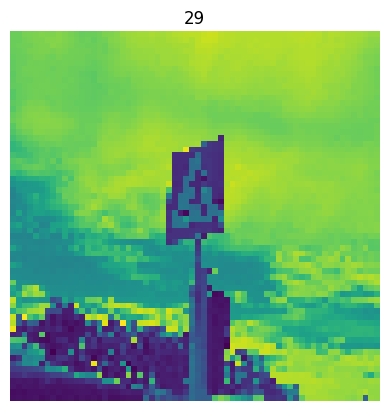

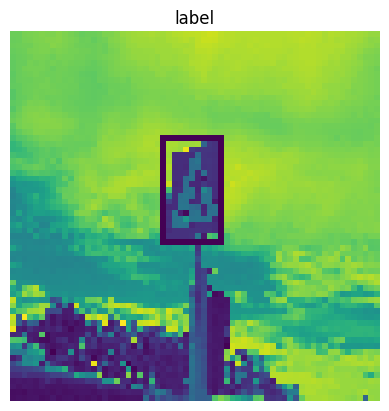

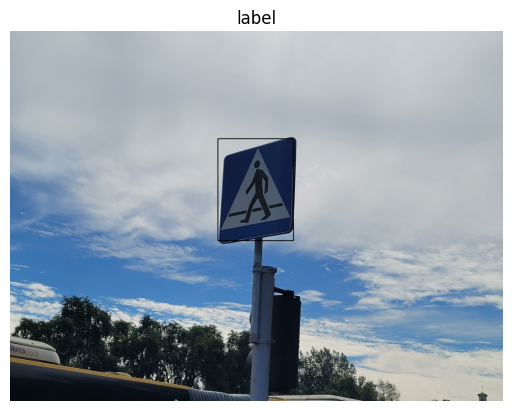

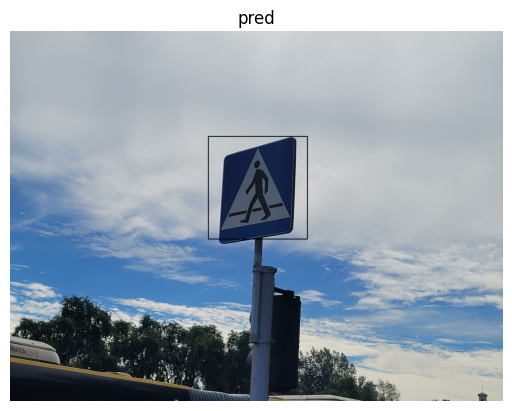

In [16]:
file = "29"
image = tf.io.read_file(file+".jpg")
image = tf.io.decode_jpeg(image, channels=1)
image = tf.image.resize(image, [64, 64])

image_batch = tf.expand_dims(image, axis=0)
predictions = model_det.predict(image_batch)
print(predictions)

label = tf.io.read_file(file+".csv")
label = tf.strings.split(label, sep=',')
label = tf.strings.to_number(label, out_type=tf.float32)
print(label)
show(image, file)

with open(file+".csv") as csvfile:
    bounding_boxes = [list(map(float, row)) for row in csv.reader(csvfile, delimiter=',')]
box = bounding_boxes[0]
box = np.array([box[1],box[0],box[3],box[2]])

draw_bb(image_batch,box,'label',1)

image = tf.io.read_file(file+".jpg")
image = tf.io.decode_jpeg(image)
image_batch = tf.expand_dims(image, axis=0)
image_float = tf.image.convert_image_dtype(image_batch, tf.float32)

draw_bb(image_float,box,'label')

box = predictions[0]
box = np.array([box[1],box[0],box[3],box[2]])
draw_bb(image_float,box,'pred')

['./dataset/detection/test\\1199', './dataset/detection/test\\1201', './dataset/detection/test\\1215', './dataset/detection/test\\1229', './dataset/detection/test\\1240', './dataset/detection/test\\1241', './dataset/detection/test\\1243', './dataset/detection/test\\1268', './dataset/detection/test\\1303', './dataset/detection/test\\1304', './dataset/detection/test\\1306', './dataset/detection/test\\1320', './dataset/detection/test\\14', './dataset/detection/test\\1476', './dataset/detection/test\\1516', './dataset/detection/test\\1535', './dataset/detection/test\\28', './dataset/detection/test\\3', './dataset/detection/test\\38', './dataset/detection/test\\7']
1/1 [==============================] - 0s 87ms/step
[[0.1989048  0.00214623 0.38342258 0.2694133 ]]
tf.Tensor([0.125      0.01111745 0.29       0.21123147], shape=(4,), dtype=float32)
1/1 [==============================] - 0s 67ms/step
[[0.56246984 0.00153683 0.7074184  0.2859628 ]]
tf.Tensor([0.57       0.02221578 0.72833335 0.2

C:\Users\klaud\AppData\Local\Temp\ipykernel_1672\93632620.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


tf.Tensor([0.30833334 0.37987146 0.49166667 0.6308976 ], shape=(4,), dtype=float32)
1/1 [==============================] - 0s 71ms/step
[[0.19535428 0.4156658  0.38533285 0.6192591 ]]
tf.Tensor([0.15833333 0.45333335 0.375      0.71555555], shape=(4,), dtype=float32)
1/1 [==============================] - 0s 66ms/step
[[0.50091606 0.41532546 0.7614622  0.75115585]]
tf.Tensor([0.51       0.4262857  0.79       0.77930355], shape=(4,), dtype=float32)
1/1 [==============================] - 0s 66ms/step
[[0.45461923 0.0872952  0.6640473  0.4164671 ]]
tf.Tensor([0.43666667 0.04666667 0.675      0.3888889 ], shape=(4,), dtype=float32)
1/1 [==============================] - 0s 72ms/step
[[0.24373151 0.18000548 0.44172773 0.45562235]]
tf.Tensor([0.18       0.13555555 0.42833334 0.5177778 ], shape=(4,), dtype=float32)
1/1 [==============================] - 0s 69ms/step
[[0.3321961  0.38246086 0.51999986 0.66138625]]
tf.Tensor([0.30166668 0.31333333 0.47666666 0.6933333 ], shape=(4,), dtype=float

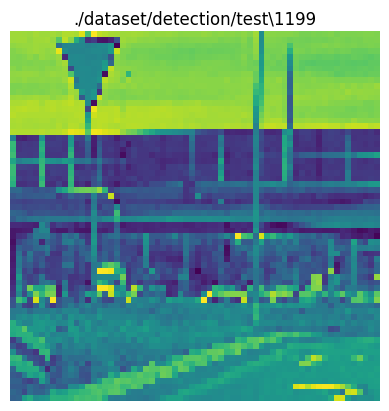

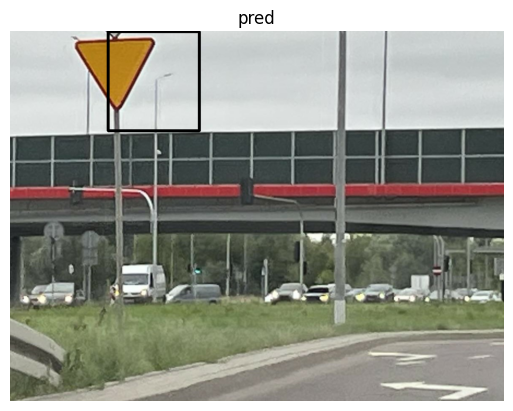

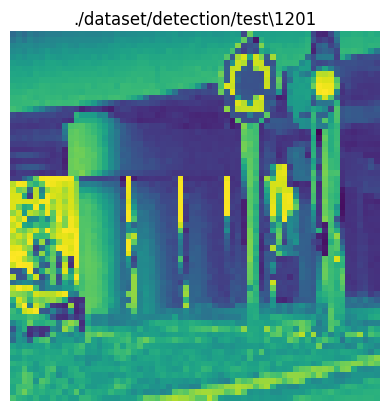

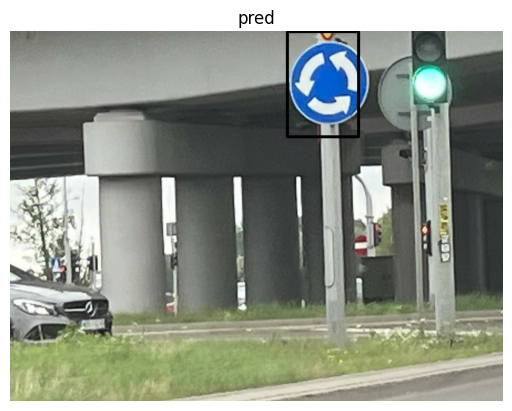

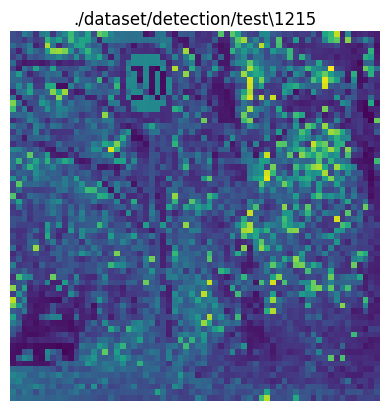

...

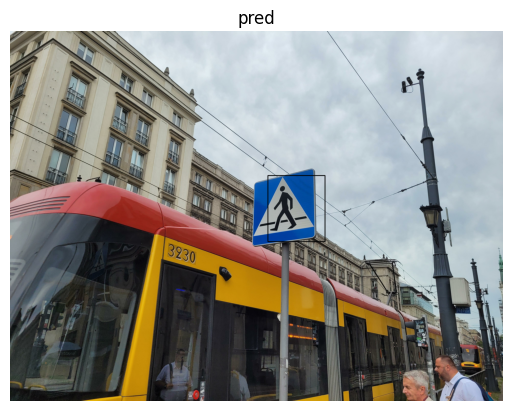

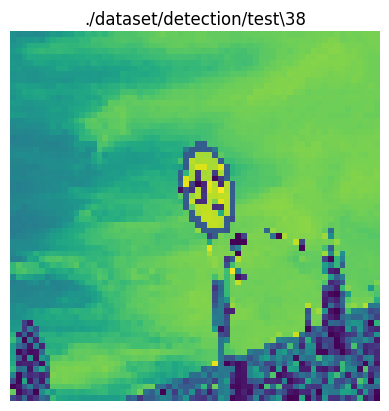

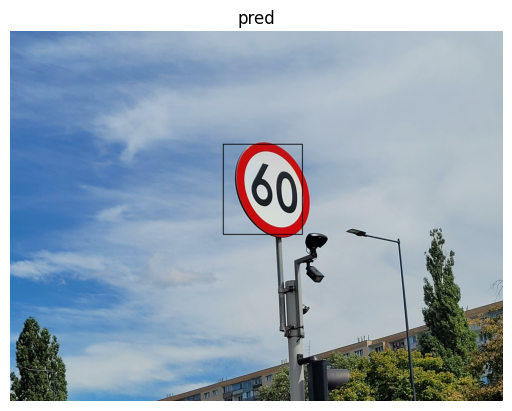

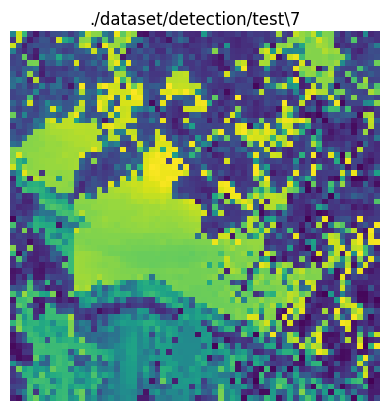

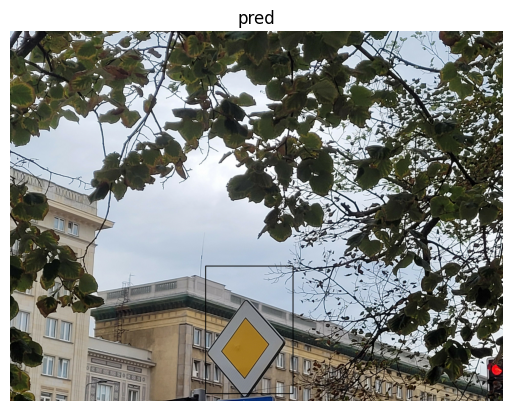

In [19]:
from os import listdir
from os.path import isfile, join
from pathlib import Path
mypath = "./dataset/detection/test"
files = [join(mypath, Path(f).stem) for f in listdir(mypath) if f.endswith('.jpg')]
print(files)
for file in files:
    image = tf.io.read_file(file+".jpg")
    image = tf.io.decode_jpeg(image, channels=1)
    image = tf.image.resize(image, [64, 64])
    
    image_batch = tf.expand_dims(image, axis=0)
    predictions = model_det.predict(image_batch)
    print(predictions)
    
    label = tf.io.read_file(file+".csv")
    label = tf.strings.split(label, sep=',')
    label = tf.strings.to_number(label, out_type=tf.float32)
    print(label)
    show(image, file)
    
    image = tf.io.read_file(file+".jpg")
    image = tf.io.decode_jpeg(image)
    image_batch = tf.expand_dims(image, axis=0)
    image_float = tf.image.convert_image_dtype(image_batch, tf.float32)
    
    # with open(file+".csv") as csvfile:
    #     bounding_boxes = [list(map(float, row)) for row in csv.reader(csvfile, delimiter=',')]
    # box = bounding_boxes[0]
    # box = np.array([box[1],box[0],box[3],box[2]])
    # draw_bb(image_float,box,'label')
    
    box = predictions[0]
    box = np.array([box[1],box[0],box[3],box[2]])
    draw_bb(image_float,box,'pred')

In [20]:
y_test = []
x_test = []
for image, label in val_ds:
    y_test.append(label)
    x_test.append(image)
x_test = np.concatenate(x_test)
y_test = np.concatenate(y_test)
print(y_test)
y_prediction = model_det.predict(x_test)
print(y_prediction)
err = [calc_abs_error(y_test[i],y_prediction[i]) for i in range(len(y_test))]
print(err)

[[0.345      0.02887063 0.555      0.28870627]
 [0.46       0.03776411 0.73333335 0.3909696 ]
 [0.38666666 0.47984752 0.785      0.9641381 ]
 ...
 [0.37666667 0.3954962  0.47833332 0.54214084]
 [0.195      0.779446   0.355      0.9770833 ]
 [0.62166667 0.45777777 0.82166666 0.7088889 ]]
125/125 [==============================] - 59s 471ms/step
[[0.38695523 0.01427684 0.5624002  0.33703595]
 [0.49373573 0.03753174 0.72220486 0.3985172 ]
 [0.4179096  0.45102483 0.79846674 0.949981  ]
 ...
 [0.33400983 0.37112227 0.44610357 0.5535663 ]
 [0.16665582 0.73946536 0.4006985  0.9982567 ]
 [0.56425136 0.4493688  0.76827395 0.6668645 ]]
[0.112278916, 0.05264416, 0.08768946, 0.18225282, 0.16263336, 0.18137442, 0.08126047, 0.09364575, 0.18339695, 0.10902679, 0.18373126, 0.10953951, 0.06593704, 0.122596085, 0.087851286, 0.14315255, 0.09495291, 0.15970649, 0.1505244, 0.07884964, 0.1356085, 0.14623854, 0.15971495, 0.08263087, 0.10226315, 0.07223496, 0.14608522, 0.13876602, 0.10168058, 0.105389535, 0.0

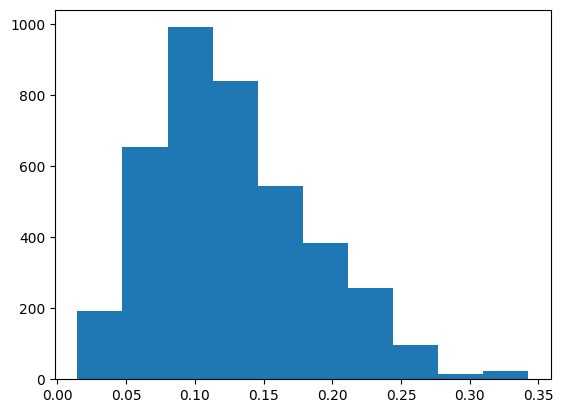

In [21]:
plt.hist(err)
plt.show()

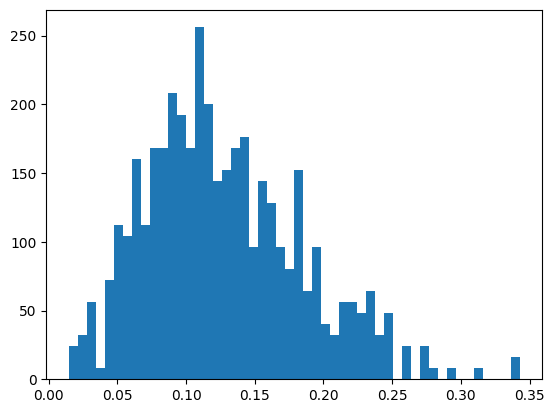

In [22]:
plt.hist(err,50)
plt.show()

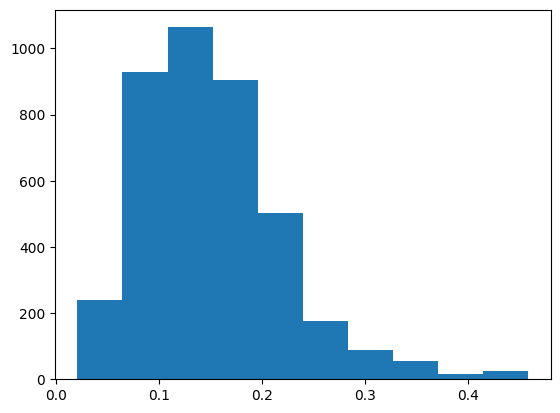

In [49]:
#size: 128x128
plt.hist(err)
plt.show()

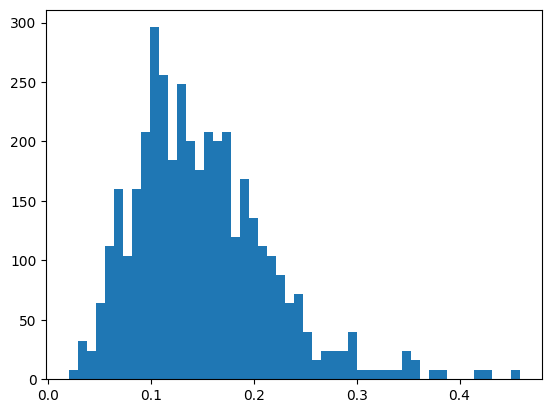

In [50]:
#size: 128x128
plt.hist(err,50)
plt.show()

In [23]:
from statistics import mean 
print(mean(err))

0.12758082


In [84]:
inp = keras.layers.Input(shape=(64, 64, 1))
x = keras.layers.RandomBrightness((-0.05,0.05))(inp)
x = keras.layers.RandomContrast(0.05)(x)
x = keras.layers.GaussianNoise(2.5)(x)
x = keras.layers.Resizing(64, 64)(x)
x = keras.layers.Rescaling(1./255,input_shape=(64, 64, 1))(x)
x = keras.layers.Conv2D(128, 7, activation="relu", padding="same")(x)
x = keras.layers.MaxPooling2D(2)(x)
x = keras.layers.Conv2D(256, 3, activation="relu", padding="same")(x)
x = keras.layers.Conv2D(256, 3, activation="relu", padding="same")(x)
x = keras.layers.MaxPooling2D(2)(x)
x = keras.layers.Conv2D(512, 3, activation="relu", padding="same")(x)
x = keras.layers.Conv2D(512, 3, activation="relu", padding="same")(x)
x = keras.layers.MaxPooling2D(2)(x)
x = keras.layers.Flatten()(x)
x = keras.layers.Dense(256, activation="relu")(x)
x = keras.layers.Dropout(0.5)(x)
x = keras.layers.Dense(128, activation="relu")(x)
x = keras.layers.Dropout(0.5)(x)
# out1 = keras.layers.Dense(2, activation='softmax', name='class_output')(x)
out1 = keras.layers.Dense(1, activation='sigmoid', name='class_output')(x)
out2 = keras.layers.Dense(4, activation='sigmoid', name='loc_output')(x)
model = keras.models.Model(inputs=inp, outputs=[out1, out2])

model.compile(loss=["binary_crossentropy", "mse"],
 loss_weights=[0.8, 0.2],
 optimizer="sgd", metrics=["accuracy"], run_eagerly=True)

In [29]:
data_augmentation_det = tf.keras.Sequential([
    keras.layers.RandomBrightness((-0.05,0.05)), # +-5%
    keras.layers.RandomContrast(0.05), # +-5%
    keras.layers.GaussianNoise(2.5), # 95% of samples fall between -2 * st_dev and +2 * st_dev => [-5; +5]
])

model_det = keras.models.Sequential([
    data_augmentation_det,
    keras.layers.Resizing(64, 64),
    keras.layers.Rescaling(1./255,input_shape=(64, 64, 1)),
    keras.layers.Conv2D(128, 7, activation="relu", padding="same"),
    keras.layers.MaxPooling2D(2),
    keras.layers.Conv2D(256, 3, activation="relu", padding="same"),
    keras.layers.Conv2D(256, 3, activation="relu", padding="same"),
    keras.layers.MaxPooling2D(2),
    keras.layers.Conv2D(512, 3, activation="relu", padding="same"),
    keras.layers.Conv2D(512, 3, activation="relu", padding="same"),
    keras.layers.MaxPooling2D(2),
    keras.layers.Flatten(),
    keras.layers.Dense(256, activation="relu"),
    keras.layers.Dropout(0.5),
    keras.layers.Dense(128, activation="relu"),
    keras.layers.Dropout(0.5),
    # keras.layers.GlobalAveragePooling2D(),
    keras.layers.Dense(5, activation="sigmoid")
])

model_det.compile(loss="mse",
 optimizer="adam",# metrics=[tf.keras.metrics.MeanIoU(num_classes=1)], run_eagerly=True)
 # metrics=[calculate_iou], run_eagerly=True)
 metrics=["accuracy"], run_eagerly=True)

In [55]:
def get_img_lbl_det2(file_path):
    img = tf.io.read_file(file_path)
    img = tf.io.decode_jpeg(img, channels=1)
    img = tf.image.resize(img, [64, 64])

    label = tf.constant([0, 0, 0, 0, 0], dtype=tf.float32)

    filename = tf.strings.regex_replace(file_path, '.jpg', '.csv')
    
    def file_exists(file_path):
        file_path_str = file_path.numpy().decode("utf-8")
        return tf.io.gfile.exists(file_path_str)

    file_exists_tensor = tf.py_function(file_exists, [filename], tf.bool)

    if tf.equal(file_exists_tensor, True):
        label = tf.io.read_file(filename)
        label = tf.strings.split(label, sep=',')
        label = tf.strings.to_number(label, out_type=tf.float32)
        const = tf.constant([1], dtype=tf.float32)
        label = tf.concat([const, label], -1)
    return img, label

In [79]:
def get_img_lbl_det2(file_path):
    img = tf.io.read_file(file_path)
    img = tf.io.decode_jpeg(img, channels=1)
    img = tf.image.resize(img, [64, 64])

    class_label = tf.constant(0, dtype=tf.int32)
    loc_label = tf.constant([0, 0, 0, 0], dtype=tf.float32)

    filename = tf.strings.regex_replace(file_path, '.jpg', '.csv')
    
    def file_exists(file_path):
        file_path_str = file_path.numpy().decode("utf-8")
        return tf.io.gfile.exists(file_path_str)

    file_exists_tensor = tf.py_function(file_exists, [filename], tf.bool)

    if tf.equal(file_exists_tensor, True):
        label_data = tf.io.read_file(filename)
        label_data = tf.strings.split(label_data, sep=',')
        
        class_label = tf.constant(1, dtype=tf.int32)

        loc_label = tf.strings.to_number(label_data, out_type=tf.float32)

    label = (class_label, loc_label)
    return img, label


In [80]:
data_dir = pathlib.Path("./dataset/detection/train2")
image_count = len(list(data_dir.glob('*.jpg')))
print(image_count)
list_ds = tf.data.Dataset.list_files(str(data_dir/'*.jpg'), shuffle=False)
list_ds = list_ds.shuffle(image_count, reshuffle_each_iteration=False)
list_ds = list_ds.repeat(40) # 500 * 40 = 20 000
image_count = len(list_ds)
print(image_count)
val_size = int(image_count * 0.2)
train_ds = list_ds.skip(val_size)
val_ds = list_ds.take(val_size)
print(tf.data.experimental.cardinality(train_ds).numpy())
print(tf.data.experimental.cardinality(val_ds).numpy())
train_ds = train_ds.map(get_img_lbl_det2, num_parallel_calls=AUTOTUNE)
val_ds = val_ds.map(get_img_lbl_det2, num_parallel_calls=AUTOTUNE)
train_ds = configure_for_performance(train_ds)
val_ds = configure_for_performance(val_ds)

for image, label in train_ds.take(1):
    print("Image shape: ", image.numpy().shape)
    print(label)
    # class_label, loc_label = label
    # print("Class Label: ", class_label.numpy())
    # print("Location Label: ", loc_label.numpy())

1000
40000
32000
8000
Image shape:  (32, 64, 64, 1)
(<tf.Tensor: shape=(32,), dtype=int32, numpy=
array([1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0,
       1, 0, 0, 0, 0, 1, 1, 1, 1, 1])>, <tf.Tensor: shape=(32, 4), dtype=float32, numpy=
array([[0.80333334, 0.4154564 , 0.90833336, 0.54653627],
       [0.        , 0.        , 0.        , 0.        ],
       [0.55      , 0.01555869, 0.635     , 0.12224685],
       [0.        , 0.        , 0.        , 0.        ],
       [0.20333333, 0.29333332, 0.365     , 0.5288889 ],
       [0.        , 0.        , 0.        , 0.        ],
       [0.43666667, 0.04666667, 0.675     , 0.3888889 ],
       [0.        , 0.        , 0.        , 0.        ],
       [0.20166667, 0.37111112, 0.30833334, 0.5133333 ],
       [0.        , 0.        , 0.        , 0.        ],
       [0.595     , 0.00666667, 0.72833335, 0.19555555],
       [0.        , 0.        , 0.        , 0.        ],
       [0.565     , 0.34897956, 0.66833335, 0.49790713],

In [83]:
history = model.fit(train_ds, validation_data=val_ds, epochs=5)

Epoch 1/5
1000/1000 [==============================] - 1802s 2s/step - loss: 0.5820 - class_output_loss: 0.6930 - loc_output_loss: 0.1379 - class_output_accuracy: 0.5160 - loc_output_accuracy: 0.3056 - val_loss: 0.5751 - val_class_output_loss: 0.6901 - val_loc_output_loss: 0.1148 - val_class_output_accuracy: 0.5350 - val_loc_output_accuracy: 0.2670
Epoch 2/5
1000/1000 [==============================] - 21362s 21s/step - loss: 0.5762 - class_output_loss: 0.6922 - loc_output_loss: 0.1124 - class_output_accuracy: 0.5210 - loc_output_accuracy: 0.2777 - val_loss: 0.5676 - val_class_output_loss: 0.6828 - val_loc_output_loss: 0.1068 - val_class_output_accuracy: 0.5600 - val_loc_output_accuracy: 0.2680
Epoch 3/5
1000/1000 [==============================] - 21071s 21s/step - loss: 0.5658 - class_output_loss: 0.6808 - loc_output_loss: 0.1056 - class_output_accuracy: 0.5604 - loc_output_accuracy: 0.2759 - val_loss: 0.5547 - val_class_output_loss: 0.6678 - val_loc_output_loss: 0.1022 - val_class_o

In [85]:
history1x = model.fit(train_ds, validation_data=val_ds, epochs=5)

Epoch 1/5
1000/1000 [==============================] - 2010s 2s/step - loss: 0.5814 - class_output_loss: 0.6936 - loc_output_loss: 0.1323 - class_output_accuracy: 0.5059 - loc_output_accuracy: 0.2126 - val_loss: 0.5741 - val_class_output_loss: 0.6906 - val_loc_output_loss: 0.1081 - val_class_output_accuracy: 0.5570 - val_loc_output_accuracy: 0.2670
Epoch 2/5
1000/1000 [==============================] - 1630s 2s/step - loss: 0.5749 - class_output_loss: 0.6926 - loc_output_loss: 0.1043 - class_output_accuracy: 0.5236 - loc_output_accuracy: 0.2353 - val_loss: 0.5673 - val_class_output_loss: 0.6847 - val_loc_output_loss: 0.0978 - val_class_output_accuracy: 0.5470 - val_loc_output_accuracy: 0.2240
Epoch 3/5
1000/1000 [==============================] - 1605s 2s/step - loss: 0.5680 - class_output_loss: 0.6851 - loc_output_loss: 0.0997 - class_output_accuracy: 0.5460 - loc_output_accuracy: 0.2334 - val_loss: 0.5561 - val_class_output_loss: 0.6719 - val_loc_output_loss: 0.0931 - val_class_outpu

In [86]:
history2x = model.fit(train_ds, validation_data=val_ds, epochs=10, initial_epoch=history1x.epoch[-1])

Epoch 5/10
1000/1000 [==============================] - 1521s 2s/step - loss: 0.5285 - class_output_loss: 0.6378 - loc_output_loss: 0.0912 - class_output_accuracy: 0.6240 - loc_output_accuracy: 0.2477 - val_loss: 0.5098 - val_class_output_loss: 0.6163 - val_loc_output_loss: 0.0841 - val_class_output_accuracy: 0.6390 - val_loc_output_accuracy: 0.2530
Epoch 6/10
1000/1000 [==============================] - 1559s 2s/step - loss: 0.5073 - class_output_loss: 0.6119 - loc_output_loss: 0.0890 - class_output_accuracy: 0.6589 - loc_output_accuracy: 0.2364 - val_loss: 0.4615 - val_class_output_loss: 0.5567 - val_loc_output_loss: 0.0807 - val_class_output_accuracy: 0.7040 - val_loc_output_accuracy: 0.2700
Epoch 7/10
1000/1000 [==============================] - 1600s 2s/step - loss: 0.4608 - class_output_loss: 0.5542 - loc_output_loss: 0.0871 - class_output_accuracy: 0.7078 - loc_output_accuracy: 0.2340 - val_loss: 0.3697 - val_class_output_loss: 0.4422 - val_loc_output_loss: 0.0798 - val_class_ou

In [87]:
model.save('model_det_bin_10epoch.keras')

In [88]:
model.compile(loss=["binary_crossentropy", "mse"],
 loss_weights=[0.2, 0.8],
 optimizer="sgd", metrics=["accuracy"], run_eagerly=True)

In [89]:
history3x = model.fit(train_ds, validation_data=val_ds, epochs=10)

Epoch 1/10
1000/1000 [==============================] - 1578s 2s/step - loss: 0.0457 - class_output_loss: 0.0378 - loc_output_loss: 0.0477 - class_output_accuracy: 0.9931 - loc_output_accuracy: 0.3593 - val_loss: 0.0171 - val_class_output_loss: 0.0058 - val_loc_output_loss: 0.0199 - val_class_output_accuracy: 1.0000 - val_loc_output_accuracy: 0.4980
Epoch 2/10
1000/1000 [==============================] - 1533s 2s/step - loss: 0.0344 - class_output_loss: 0.0290 - loc_output_loss: 0.0357 - class_output_accuracy: 0.9962 - loc_output_accuracy: 0.3963 - val_loss: 0.0129 - val_class_output_loss: 0.0043 - val_loc_output_loss: 0.0150 - val_class_output_accuracy: 1.0000 - val_loc_output_accuracy: 0.5390
Epoch 3/10
1000/1000 [==============================] - 1489s 1s/step - loss: 0.0289 - class_output_loss: 0.0246 - loc_output_loss: 0.0300 - class_output_accuracy: 0.9968 - loc_output_accuracy: 0.4128 - val_loss: 0.0101 - val_class_output_loss: 0.0033 - val_loc_output_loss: 0.0118 - val_class_ou

In [90]:
model.save('model_det_bin_10epoch82_10epoch28.keras')

In [91]:
history4x = model.fit(train_ds, validation_data=val_ds, epochs=10)

Epoch 1/10
1000/1000 [==============================] - 1767s 2s/step - loss: 0.0139 - class_output_loss: 0.0113 - loc_output_loss: 0.0146 - class_output_accuracy: 0.9989 - loc_output_accuracy: 0.4989 - val_loss: 0.0035 - val_class_output_loss: 0.0011 - val_loc_output_loss: 0.0041 - val_class_output_accuracy: 1.0000 - val_loc_output_accuracy: 0.6600
Epoch 2/10
1000/1000 [==============================] - 1627s 2s/step - loss: 0.0131 - class_output_loss: 0.0104 - loc_output_loss: 0.0138 - class_output_accuracy: 0.9991 - loc_output_accuracy: 0.5046 - val_loss: 0.0034 - val_class_output_loss: 6.9913e-04 - val_loc_output_loss: 0.0041 - val_class_output_accuracy: 1.0000 - val_loc_output_accuracy: 0.6490
Epoch 3/10
1000/1000 [==============================] - 1652s 2s/step - loss: 0.0126 - class_output_loss: 0.0104 - loc_output_loss: 0.0131 - class_output_accuracy: 0.9987 - loc_output_accuracy: 0.5120 - val_loss: 0.0029 - val_class_output_loss: 9.7445e-04 - val_loc_output_loss: 0.0033 - val_

In [92]:
model.save('model_det_bin_10epoch82_20epoch28.keras')

In [93]:
model.compile(loss=["binary_crossentropy", "mse"],
 loss_weights=[0.05, 0.95],
 optimizer="sgd", metrics=["accuracy"], run_eagerly=True)

In [94]:
history5x = model.fit(train_ds, validation_data=val_ds, epochs=5)

Epoch 1/5
1000/1000 [==============================] - 1665s 2s/step - loss: 0.0090 - class_output_loss: 0.0105 - loc_output_loss: 0.0089 - class_output_accuracy: 0.9994 - loc_output_accuracy: 0.5373 - val_loss: 0.0022 - val_class_output_loss: 0.0024 - val_loc_output_loss: 0.0022 - val_class_output_accuracy: 1.0000 - val_loc_output_accuracy: 0.6710
Epoch 2/5
1000/1000 [==============================] - 1591s 2s/step - loss: 0.0088 - class_output_loss: 0.0116 - loc_output_loss: 0.0086 - class_output_accuracy: 0.9994 - loc_output_accuracy: 0.5422 - val_loss: 0.0021 - val_class_output_loss: 0.0024 - val_loc_output_loss: 0.0020 - val_class_output_accuracy: 1.0000 - val_loc_output_accuracy: 0.6920
Epoch 3/5
1000/1000 [==============================] - 1613s 2s/step - loss: 0.0085 - class_output_loss: 0.0123 - loc_output_loss: 0.0083 - class_output_accuracy: 0.9993 - loc_output_accuracy: 0.5418 - val_loss: 0.0019 - val_class_output_loss: 0.0023 - val_loc_output_loss: 0.0019 - val_class_outpu

In [98]:
model.save('model_det_bin_class100loc69.keras')

In [108]:
model.compile(loss=["binary_crossentropy", "mse"],
 loss_weights=[0.05, 0.95],
 optimizer="sgd", metrics=["accuracy",calc_abs_error], run_eagerly=True)

In [101]:
history6x = model.fit(train_ds, validation_data=val_ds, epochs=10)

Epoch 1/10
1000/1000 [==============================] - 1676s 2s/step - loss: 0.0074 - class_output_loss: 0.0126 - loc_output_loss: 0.0072 - class_output_accuracy: 0.9990 - class_output_calc_abs_error: 0.0458 - loc_output_accuracy: 0.5470 - loc_output_calc_abs_error: 0.1878 - val_loss: 0.0016 - val_class_output_loss: 0.0031 - val_loc_output_loss: 0.0015 - val_class_output_accuracy: 1.0000 - val_class_output_calc_abs_error: 0.0130 - val_loc_output_accuracy: 0.6670 - val_loc_output_calc_abs_error: 0.0900
Epoch 2/10
1000/1000 [==============================] - 1902s 2s/step - loss: 0.0073 - class_output_loss: 0.0122 - loc_output_loss: 0.0070 - class_output_accuracy: 0.9991 - class_output_calc_abs_error: 0.0447 - loc_output_accuracy: 0.5470 - loc_output_calc_abs_error: 0.1938 - val_loss: 0.0016 - val_class_output_loss: 0.0029 - val_loc_output_loss: 0.0015 - val_class_output_accuracy: 1.0000 - val_class_output_calc_abs_error: 0.0115 - val_loc_output_accuracy: 0.6880 - val_loc_output_calc_ab

In [103]:
model.save('model_det_bin_class100loc65err084.keras')

In [113]:
model = tf.keras.models.load_model('model_det_bin_class100loc69.keras')

In [114]:
history7x = model.fit(train_ds, validation_data=val_ds, epochs=5)

Epoch 1/5
1000/1000 [==============================] - 1638s 2s/step - loss: 0.0078 - class_output_loss: 0.0130 - loc_output_loss: 0.0076 - class_output_accuracy: 0.9989 - loc_output_accuracy: 0.5461 - val_loss: 0.0018 - val_class_output_loss: 0.0031 - val_loc_output_loss: 0.0017 - val_class_output_accuracy: 1.0000 - val_loc_output_accuracy: 0.6820
Epoch 2/5
1000/1000 [==============================] - 1641s 2s/step - loss: 0.0077 - class_output_loss: 0.0127 - loc_output_loss: 0.0074 - class_output_accuracy: 0.9991 - loc_output_accuracy: 0.5415 - val_loss: 0.0017 - val_class_output_loss: 0.0029 - val_loc_output_loss: 0.0017 - val_class_output_accuracy: 1.0000 - val_loc_output_accuracy: 0.6730
Epoch 3/5
1000/1000 [==============================] - 1607s 2s/step - loss: 0.0074 - class_output_loss: 0.0120 - loc_output_loss: 0.0072 - class_output_accuracy: 0.9992 - loc_output_accuracy: 0.5445 - val_loss: 0.0018 - val_class_output_loss: 0.0027 - val_loc_output_loss: 0.0017 - val_class_outpu

In [115]:
model.save('model_det_bin_class100loc685.keras')

['./dataset/detection/test2\\1201', './dataset/detection/test2\\1215', './dataset/detection/test2\\1268', './dataset/detection/test2\\1320', './dataset/detection/test2\\1365', './dataset/detection/test2\\1366', './dataset/detection/test2\\1368', './dataset/detection/test2\\1369', './dataset/detection/test2\\1370', './dataset/detection/test2\\14', './dataset/detection/test2\\1476', './dataset/detection/test2\\28', './dataset/detection/test2\\3', './dataset/detection/test2\\38', './dataset/detection/test2\\7', './dataset/detection/test2\\m1', './dataset/detection/test2\\m21', './dataset/detection/test2\\m26', './dataset/detection/test2\\m33', './dataset/detection/test2\\m45']
1/1 [==============================] - 0s 156ms/step
[array([[0.998913]], dtype=float32), array([[0.5834541 , 0.08818881, 0.7814617 , 0.31771463]], dtype=float32)]
0.998913
[0.5834541  0.08818881 0.7814617  0.31771463]
1/1 [==============================] - 0s 56ms/step
[array([[0.99569756]], dtype=float32), array([

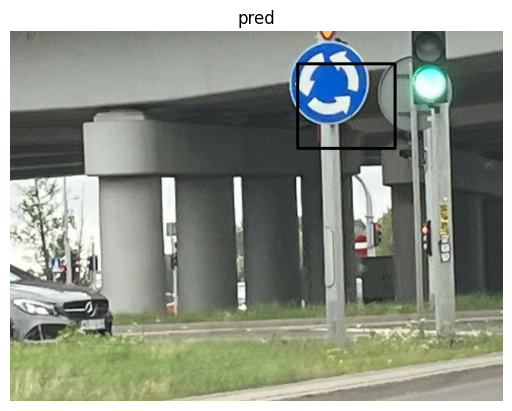

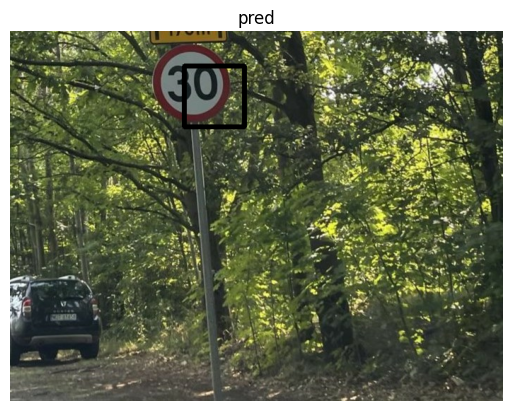

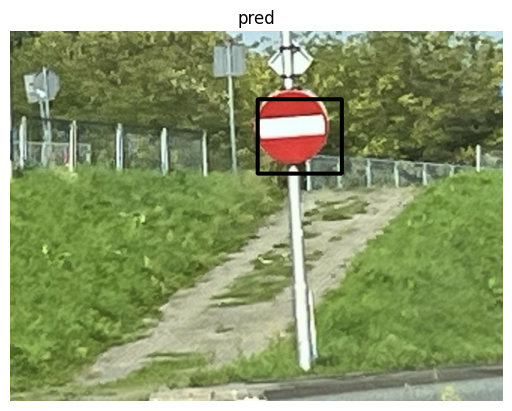

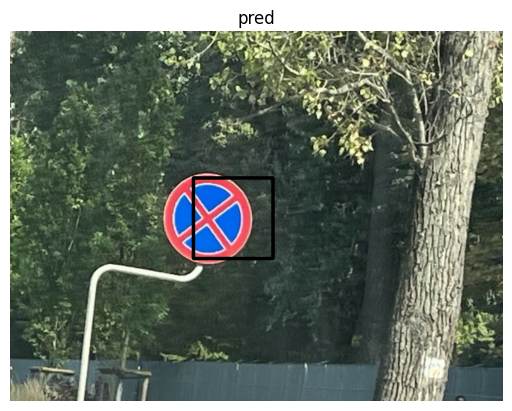

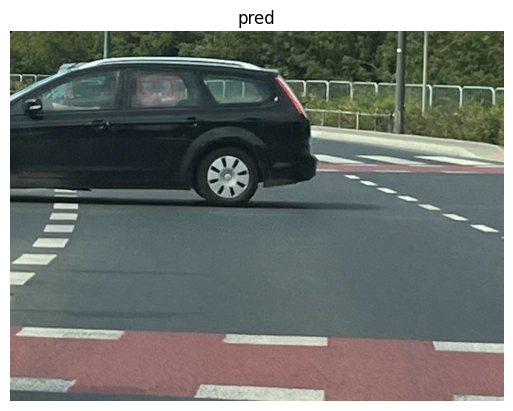

...

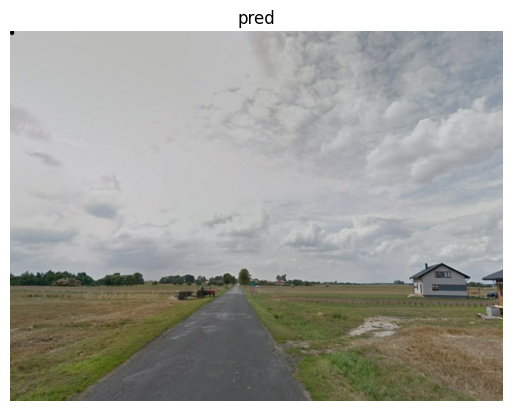

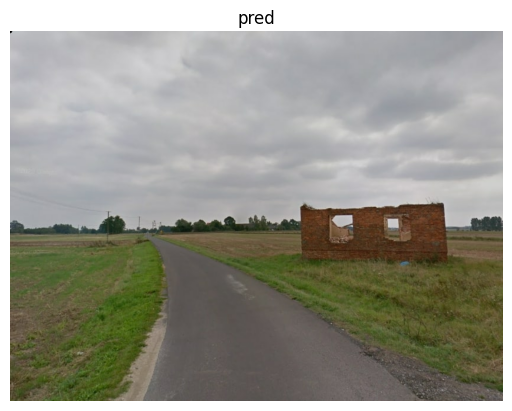

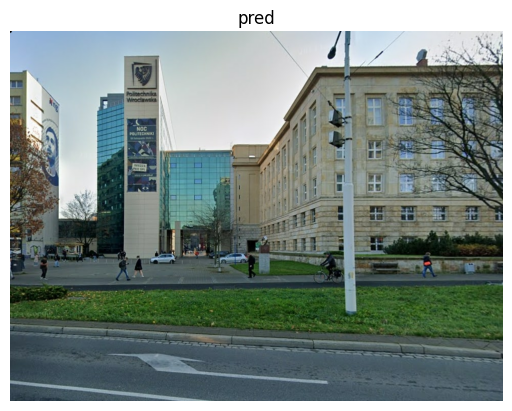

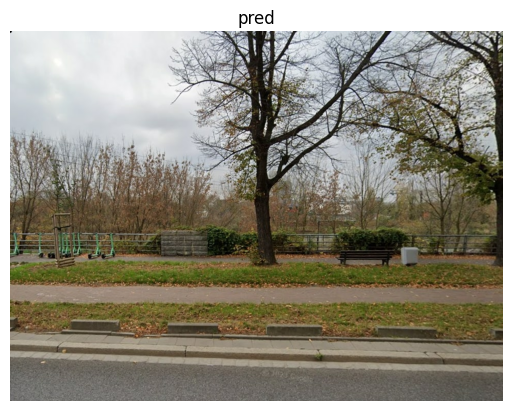

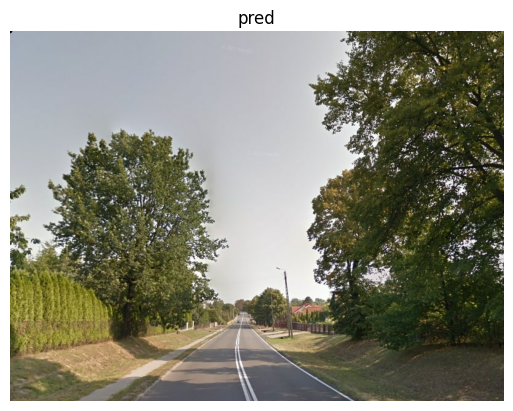

In [102]:

mypath = "./dataset/detection/test2"
files = [join(mypath, Path(f).stem) for f in listdir(mypath) if f.endswith('.jpg')]
print(files)
for file in files:
    image = tf.io.read_file(file+".jpg")
    image = tf.io.decode_jpeg(image, channels=1)
    image = tf.image.resize(image, [64, 64])
    
    image_batch = tf.expand_dims(image, axis=0)
    predictions = model.predict(image_batch)
    print(predictions)
    print(predictions[0].squeeze())
    print(predictions[1].squeeze())
    # label = tf.io.read_file(file+".csv")
    # label = tf.strings.split(label, sep=',')
    # label = tf.strings.to_number(label, out_type=tf.float32)
    # print(label)
    # show(image, file)
    
    image = tf.io.read_file(file+".jpg")
    image = tf.io.decode_jpeg(image)
    image_batch = tf.expand_dims(image, axis=0)
    image_float = tf.image.convert_image_dtype(image_batch, tf.float32)
    
    # with open(file+".csv") as csvfile:
    #     bounding_boxes = [list(map(float, row)) for row in csv.reader(csvfile, delimiter=',')]
    # box = bounding_boxes[0]
    # box = np.array([box[1],box[0],box[3],box[2]])
    # draw_bb(image_float,box,'label')

    # box = predictions.squeeze()
    # box = predictions.squeeze()[1:]
    box = predictions[1].squeeze()
    box = np.array([box[1],box[0],box[3],box[2]])
    draw_bb(image_float,box,'pred')

['./dataset/detection/test2\\1201', './dataset/detection/test2\\1215', './dataset/detection/test2\\1268', './dataset/detection/test2\\1320', './dataset/detection/test2\\1365', './dataset/detection/test2\\1366', './dataset/detection/test2\\1368', './dataset/detection/test2\\1369', './dataset/detection/test2\\1370', './dataset/detection/test2\\14', './dataset/detection/test2\\1476', './dataset/detection/test2\\28', './dataset/detection/test2\\3', './dataset/detection/test2\\38', './dataset/detection/test2\\7', './dataset/detection/test2\\m1', './dataset/detection/test2\\m21', './dataset/detection/test2\\m26', './dataset/detection/test2\\m33', './dataset/detection/test2\\m45']
1/1 [==============================] - 0s 323ms/step
[array([[0.99851286]], dtype=float32), array([[0.5629597 , 0.09098917, 0.76282376, 0.3062298 ]], dtype=float32)]
0.99851286
[0.5629597  0.09098917 0.76282376 0.3062298 ]
1/1 [==============================] - 0s 63ms/step
[array([[0.9961416]], dtype=float32), arra

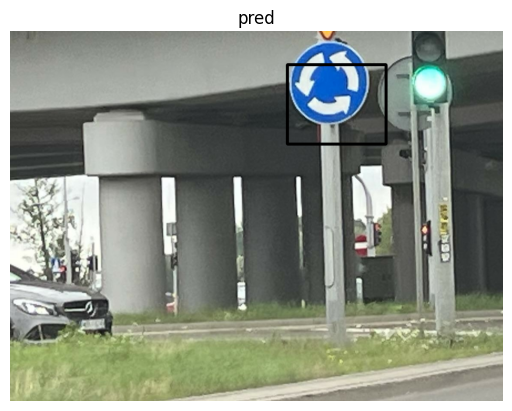

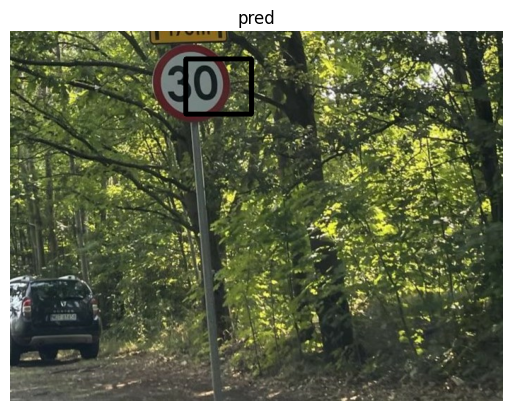

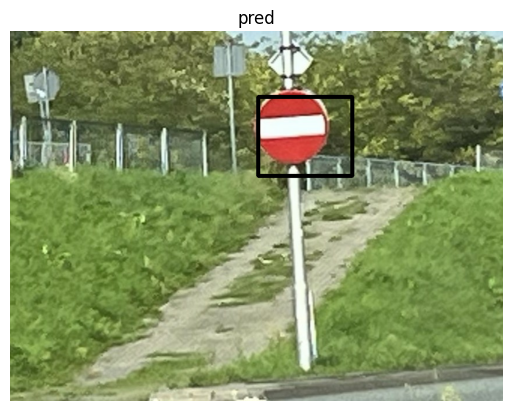

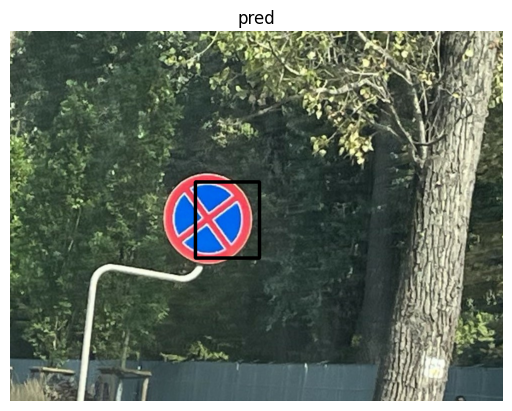

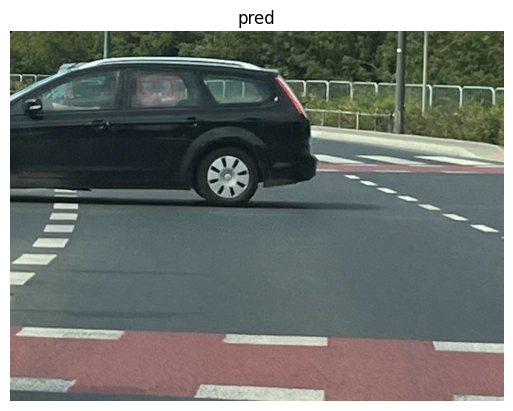

...

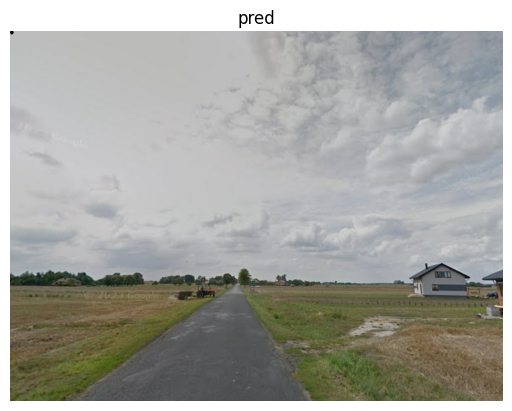

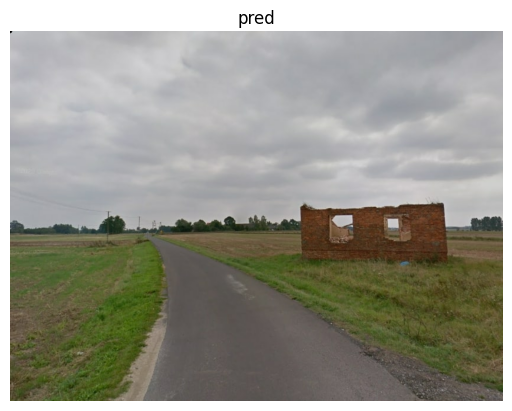

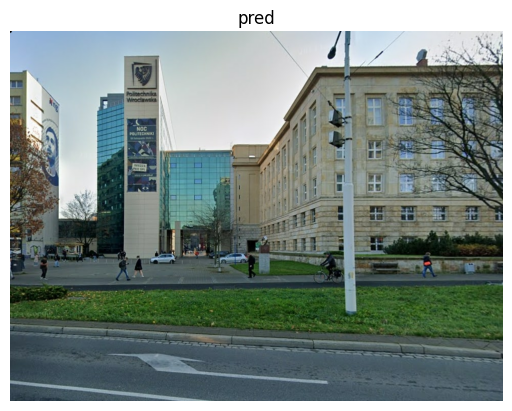

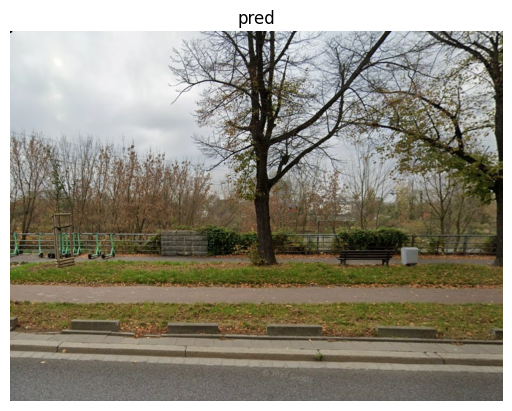

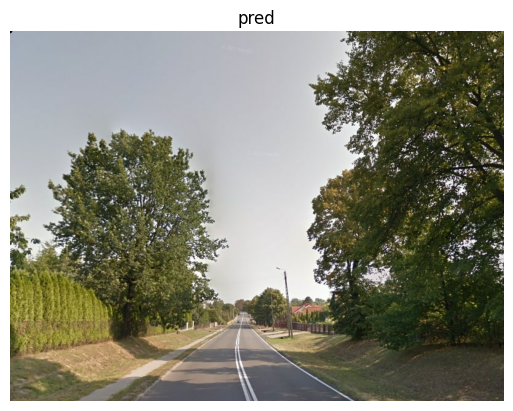

In [116]:

mypath = "./dataset/detection/test2"
files = [join(mypath, Path(f).stem) for f in listdir(mypath) if f.endswith('.jpg')]
print(files)
for file in files:
    image = tf.io.read_file(file+".jpg")
    image = tf.io.decode_jpeg(image, channels=1)
    image = tf.image.resize(image, [64, 64])
    
    image_batch = tf.expand_dims(image, axis=0)
    predictions = model.predict(image_batch)
    print(predictions)
    print(predictions[0].squeeze())
    print(predictions[1].squeeze())
    # label = tf.io.read_file(file+".csv")
    # label = tf.strings.split(label, sep=',')
    # label = tf.strings.to_number(label, out_type=tf.float32)
    # print(label)
    # show(image, file)
    
    image = tf.io.read_file(file+".jpg")
    image = tf.io.decode_jpeg(image)
    image_batch = tf.expand_dims(image, axis=0)
    image_float = tf.image.convert_image_dtype(image_batch, tf.float32)
    
    # with open(file+".csv") as csvfile:
    #     bounding_boxes = [list(map(float, row)) for row in csv.reader(csvfile, delimiter=',')]
    # box = bounding_boxes[0]
    # box = np.array([box[1],box[0],box[3],box[2]])
    # draw_bb(image_float,box,'label')

    # box = predictions.squeeze()
    # box = predictions.squeeze()[1:]
    box = predictions[1].squeeze()
    box = np.array([box[1],box[0],box[3],box[2]])
    draw_bb(image_float,box,'pred')

[[0.595      0.4023581  0.81666666 0.7469189 ]
 [0.345      0.02887063 0.555      0.28870627]
 [0.         0.         0.         0.        ]
 ...
 [0.16833334 0.04       0.42666668 0.41777778]
 [0.         0.         0.         0.        ]
 [0.8283333  0.19116141 0.955      0.5156912 ]]
250/250 [==============================] - 122s 489ms/step
[[5.6450915e-01 4.2363170e-01 7.6460421e-01 7.3809701e-01]
 [3.5301551e-01 1.1503875e-01 5.2141279e-01 2.7394065e-01]
 [1.1054103e-05 1.9784007e-05 8.0851814e-06 8.1753224e-06]
 ...
 [2.4926409e-01 1.3805497e-01 4.4599310e-01 3.9064404e-01]
 [9.2002875e-07 1.6302764e-06 3.2609427e-07 3.0943579e-07]
 [6.9498312e-01 2.1002786e-01 8.3129185e-01 5.1195389e-01]]
[0.112648815, 0.14253648, 4.7098612e-05, 0.27286994, 0.108630806, 0.1336049, 0.20031145, 0.21433423, 0.0014946798, 0.12708, 0.011103432, 0.1935612, 0.080540374, 0.0008313583, 3.1489915e-08, 0.12841359, 0.0056537646, 0.17183298, 0.13051495, 0.0017266221, 0.002906535, 0.0945138, 0.21354286, 0.0

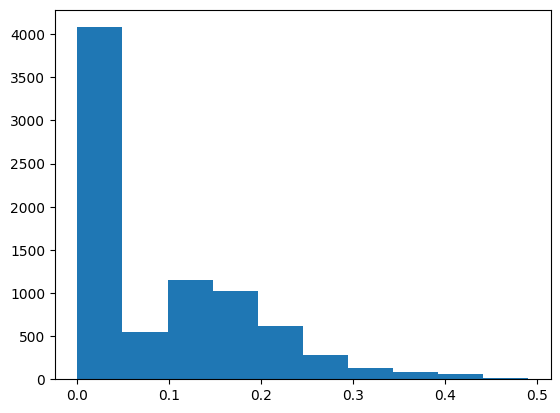

In [126]:
y_test = []
x_test = []
for image, label in val_ds:
    det, bbox = label
    # print(det)
    y_test.append(bbox)
    x_test.append(image)
x_test = np.concatenate(x_test)
y_test = np.concatenate(y_test)
print(y_test)
y_prediction = model.predict(x_test)
_, y_prediction = y_prediction
print(y_prediction)
err = [calc_abs_error(y_test[i],y_prediction[i]) for i in range(len(y_test))]
print(err)
plt.hist(err)
plt.show()

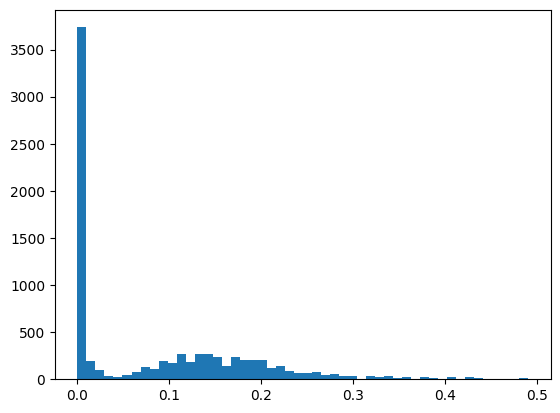

In [127]:
plt.hist(err,50)
plt.show()

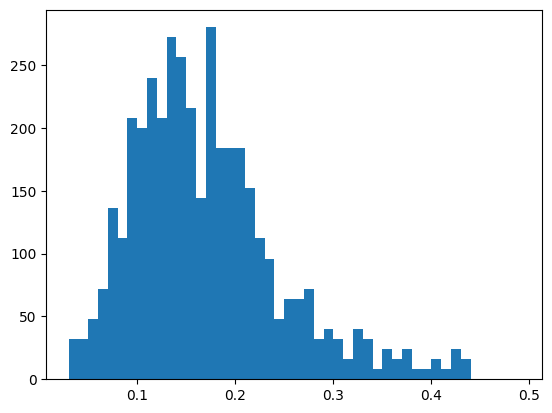

In [135]:
plt.hist(err, bins=np.arange(0.03, 0.5, 0.01))
plt.show()